In [1]:
import numpy as np
from sklearn.manifold import TSNE, MDS
from sklearn.decomposition import PCA 
from sklearn.cluster import MiniBatchKMeans, SpectralClustering
from sklearn.model_selection import train_test_split
from sklearn.neural_network import MLPClassifier
import matplotlib.pyplot as plt
from src.utils import *
from src.trajectory import *
from src.trajectory.feeding import feeding_times_start_end_dict
from src.methods import *
from src.metrics import *
from src.metrics.results_to_csv import *
from .processing import *
from .utils import *
from .plotting import *
from src.clustering.clustering import *
from src.utils.tank_area_config import *
from src.visualizations.activity_plotting import *
from src.clustering.transitions_cluster import *
from src.visualizations import *
from src.visualizations.pca_plots import * 
from fishproviz.config.config.config.config import *
from .processing import *
from .motion_video import *
from .utils import *
from .plasticity import *
from main import plotting_odd_even
import pandas as pd
%load_ext autoreload
%autoreload 2
%load_ext line_profiler  

parameters = set_parameters()
print(parameters.projectPath, BLOCK)

ModuleNotFoundError: No module named 'graph_tool'

In [5]:
DAYS = get_days(parameters)
fish_ids = get_individuals_keys(parameters)
get_clusters_func = lambda fk,d: load_clusters_concat(parameters, fk,d)
get_clusters_func(fish_ids[0], DAYS[0])

In [6]:
data = load_trajectory_data(parameters, fish_ids[0])

In [5]:
fig,ax = plt.subplots(figsize=(5,10))
ax.plot(*data[3]["area"].T)


In [12]:
data[0]["area"]

array([[ 402.,    0.],
       [   0.,  382.],
       [2683., 3073.],
       [3102., 2727.],
       [3092.,  -26.]])

In [3]:
cameras = get_camera_names(is_back=True)
days = get_all_days_of_context()
fish_keys = get_camera_pos_keys()
area_f = get_area_functions()
print(cameras[0], days)
fk = fish_keys[1]
day = days[2]
fk

23442333 ['20210911_060000', '20210912_060000', '20210913_060000', '20210914_060000', '20210915_060000', '20210916_060000', '20210917_060000', '20210918_060000', '20210919_060000', '20210920_060000', '20210921_060000', '20210922_060000', '20210923_060000', '20210924_060000', '20210925_060000', '20210926_060000', '20210927_060000', '20210928_060000', '20210929_060000', '20210930_060000', '20211001_060000', '20211002_060000', '20211003_060000', '20211004_060000', '20211005_060000', '20211006_060000', '20211007_060000', '20211008_060000']


'23484201_back'

In [93]:
create_directories()

In [99]:
startsigma=1.0
mmpy.findWatershedRegions(parameters, minimum_regions=50, startsigma=startsigma, pThreshold=[0.33, 0.67],
                         saveplot=True, endident = '*_pcaModes.mat')


Starting watershed transform...
Assigning watershed regions...
	 tempsave done.
All data saved in UMAP/zVals_wShed_groups_50.mat.


In [283]:
for key in block1_remove:
    if BLOCK in key:
        fish_keys.remove("_".join(key.split("_")[1:]))

In [10]:
block1_remove

['block1_23442333_back', 'block1_23520264_front', 'block2_23520266_front']

In [ ]:
compute_all_projections(parameters.projectPath,fish_keys, excluded_days=exclude)

In [4]:
data = load_trajectory_data_concat(parameters)

In [53]:
wshedfile = hdf5storage.loadmat('%s/%s/zVals_wShed_groups_%s.mat'%(parameters.projectPath, parameters.method,
                                                                  parameters.kmeans))

In [12]:
data["projections"].mean(axis=0),data["projections"].std(axis=0)

(array([ 0.29110114, -0.06139115,  6.11329481]),
 array([0.56032154, 1.23519272, 5.62474185]))

In [ ]:
#for k in parameters.kmeans_list:
#parameters.kmeans=k
get_clusters_func_wshed = lambda fk, d: get_regions_for_fish_key(wshedfile,fk,d)
fig, df = cluster_entropy_plot(parameters,get_clusters_func_wshed,fish_ids[:2],parameters.kmeans,
                     name=f"cluster_entropy_wshed", 
                     by_the_hour=True, fit_degree=2)

In [196]:
block1_remove = ["block1_23442333_back", "block1_23520264_front", "block2_23520266_front"]
for br in block1_remove:
    fish_ids.remove(br)

In [7]:
df = pd.read_csv(f"{parameters.projectPath}/plasticity/cluster_entropy_wshed_hourly_{parameters.kmeans}.csv")

In [8]:
parameters.kmeans

50

In [28]:
df_geq_50 = df[df.index > 0]

In [45]:
fig = plot_index_columns(df_geq_50, fish_ids[-11:-7],
                   ylabel="entropy", xlabel="hourly",title="kmeans entropy", forall=False, fit_degree=2)

In [144]:
load_trajectory_data_concat(parameters, fk=fish_ids[-3])["df_time_index"]

array([ 108014.,  108015.,  108016., ..., 4139665., 4139666., 4139667.])

In [ ]:
csv_of_the_day(fish_ids[0].split("_")[1], day=DAYS[-1], is_back=True)

In [44]:
px2cm(2264-2149,camera=fish_ids[0].split("_")[1], day=DAYS[0])*1

2.6230421868708937

In [68]:
#plasticity_cv_fig(parameters,fish_keys=fish_ids[:2],forall=False, fit_degree=2, by_the_hour=False)

In [21]:
f1["positions"],f1["projections"][:,2][:,np.newaxis]

(array([[2046., 1109.],
        [2046., 1109.],
        [2046., 1109.],
        ...,
        [2243., 1297.],
        [2243., 1292.],
        [2242., 1291.]]),
 array([[21.28471257],
        [21.28471257],
        [21.28471257],
        ...,
        [19.42395077],
        [19.42353759],
        [19.4462048 ]]))

In [32]:
get_where_hour_ends(f1['df_time_index'],7)

0

In [38]:
timex = f1['df_time_index']-f1['df_time_index'][0]

In [87]:
day_idx, f_idx = np.where(df[df.columns[1:]]>3)

In [88]:
badlist = list(zip(df.columns[1:][f_idx], np.array(DAYS)[(day_idx//8)], day_idx%8))
set(map(lambda a:f"{a[0]}_{a[1]}" ,badlist))

{'block1_23484201_front_20211002_060000',
 'block1_23484204_front_20211002_060000',
 'block1_23484204_front_20211008_060000',
 'block1_23520258_front_20211003_060000',
 'block1_23520258_front_20211006_060000',
 'block1_23520268_back_20210923_060000',
 'block1_23520270_back_20211002_060000',
 'block1_23520278_back_20210925_060000',
 'block1_23520289_back_20210925_060000',
 'block2_23484204_back_20210929_060000',
 'block2_23484204_front_20211002_060000',
 'block2_23484204_front_20211003_060000',
 'block2_23520257_back_20210919_060000',
 'block2_23520258_back_20210925_060000',
 'block2_23520258_front_20210925_060000',
 'block2_23520266_back_20211002_060000',
 'block2_23520268_back_20210920_060000',
 'block2_23520276_back_20210925_060000'}

In [60]:
cam="23520276"
day="20211114_060000"
key, data = csv_of_the_day(cam, day=day, is_back=True)

In [65]:
data_np = data[11][["xpx", "ypx"]].to_numpy()

In [66]:
area = area_f(fk+"_back",day)

In [67]:
all_error_filters(data_np, (cam+"_back",area))

DIRT: , : Found dirt: 8220 data points for [1611:9831] out of 9999, data[start]=[2252,3478] 	  	  0.08 0.64
dirt threshold: 1.00 min Dirt Sequence 27.40 min


array([ True,  True,  True, ..., False, False, False])

In [3]:
sum_data = load_trajectory_data_concat(parameters)

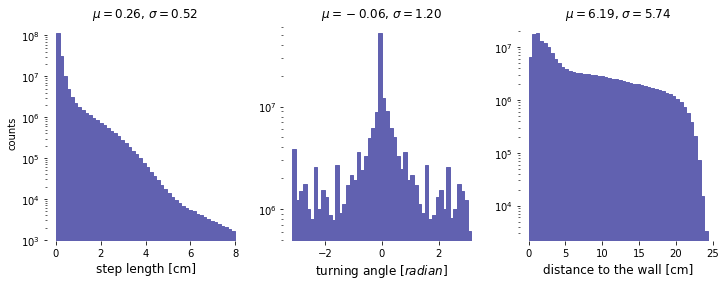

In [4]:
data = sum_data["projections"]
n_data = data
plot_feature_distribution(n_data, name="dist_example_1", n_dfs=[1],
                          names = ["step length [cm]", "turning angle [$radian$]", "distance to the wall [cm]"])

In [81]:
a,f = mm_findWavelets(data,3,parameters)

	 Calculating wavelets, clock starting.
	 Using #16 CPUs.
	 Done at 17.77 seconds.


In [64]:
f

array([0.01      , 0.01258677, 0.01584267, 0.0199408 , 0.02509901,
       0.03159154, 0.03976354, 0.05004943, 0.06299605, 0.07929166,
       0.09980256, 0.12561915, 0.15811388, 0.19901425, 0.25049458,
       0.31529168, 0.39685026, 0.49950615, 0.62871671, 0.79135103,
       0.99605505, 1.25371121, 1.57801699, 1.9862131 , 2.5       ])

In [70]:
fig = plt.figure()
ax = fig.subplots()
ax.scatter(range(a.shape[1]), a.mean(axis=0))
fig.savefig("wavelet_means_scaled_by_std")

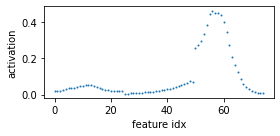

In [82]:
fig = plt.figure()
ax = fig.subplots()
ax.scatter(range(a.shape[1]), a.mean(axis=0))
ax.set_ylabel("activation")
ax.set_xlabel("feature idx")
fig.tight_layout()
fig.savefig("wavelet_means_scaled_unscaled.pdf")
fig

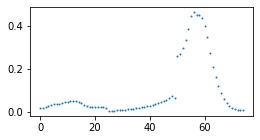

In [202]:
fig = plt.figure()
ax = fig.subplots()
ax.scatter(range(a.shape[1]), a.mean(axis=0))
fig

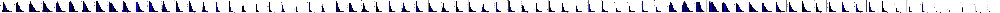

In [185]:
plot_feature_distribution(a, name="dist_wavelet", names=["f%s"%i for i in range(a.shape[1])])

In [ ]:
dirname = f"{VIS_DIR}/plasticity"
os.makedirs(dirname, exist_ok=True)

In [142]:
n_df=10
fig = plasticity_cv_fig(fish_keys[1:7], 
                name=f"{dirname}/plasticity_cv_all_df_%s_poly2"%(n_df),
                n_df=n_df, forall=True)

In [146]:

for n_df in [1,10,50]:
    plasticity_cv_fig(fish_keys[:-1], 
                name=f"{dirname}/plasticity_cv_all_df_%s_poly2"%(n_df),
                n_df=n_df, forall=True)

In [144]:
bsize=4
dirname = f"{VIS_DIR}/plasticity"
if not os.path.exists(dirname):
    os.mkdir(dirname)
for n_df in [1, 10, 50]:
    for i in range(0,len(fish_keys),bsize):
        plasticity_cv_fig(fish_keys[i:i+bsize], 
                name=f"{dirname}/plasticity_cv_df_%s_%02d-%02d"%(n_df,i,i+bsize),
                n_df=n_df)

In [177]:
y=list()
n_clusters = 7
cmap = "tab20"
block=BLOCK2
days = get_days(parameters,BLOCK2)
for d in days:
    clusters = load_clusters_concat(parameters,fk="",day=d, k=n_clusters)
    if clusters is None or len(clusters)==0: 
        dist = np.zeros(n_clusters)
    else:
        dist = get_cluster_distribution(clusters, n_clusters)
    y.append(dist)
df = pd.DataFrame(
    y,
    index=[get_date_string(d) for d in days],
    columns=["cluster %d" % (c) for c in range(n_clusters)],
)
df.plot(
    kind="area", stacked=True, colormap=cmap, figsize=(10, 5), rot=45, 
)
plt.tight_layout()
#filepath = get_results_filepath(trace_size, name, subfolder=subfolder)
plt.savefig(f"cluster_region_distribution_{block}_{n_clusters}.pdf")
plt.close()

In [8]:
sum_data = load_summerized_data(wshedfile, parameters)

In [9]:
plot_lines_for_cluster2(sum_data["positions"],
                    sum_data["projections"],
                    sum_data["area"],
                    sum_data["clusters"],
                    parameters.kmeans, 
                    fig_name=parameters.projectPath+"/cluster_characteristics_overall_stw_%s.pdf"%parameters.kmeans)

In [148]:
trainx = hdf5storage.loadmat('%s/%s/training_data.mat'%(parameters.projectPath, parameters.method))["trainingSetData"]
trainy = hdf5storage.loadmat('%s/%s/training_embedding.mat'%(parameters.projectPath, parameters.method))['trainingEmbedding']
KM = KMeans(n_clusters=10)
cluster_labels = KM.fit_predict(trainx)
print(trainy.shape)

fig = cluster_density_umap(trainy,cluster_labels, 
                           parameters.projectPath+"/kmeans_clustering_10.pdf")

(9750, 2)


In [ ]:
plot_transition_rates(get_regions_for_fish_key(wshedfile), filename=parameters.projectPath+"/overall_kmeans_10.pdf", )

In [159]:
plot_transition_rates(load_clusters_concat(parameters, k=7),
                       filename=parameters.projectPath+"/overall_kmeans_7.pdf", cluster_remap=None)

(7, 7)


<Graph object, directed, with 7 vertices and 48 edges, at 0x1ae9bf8e0>

In [160]:
clusters7 = load_clusters_concat(parameters, k=7)

In [164]:
dist=compute_cluster_distribution(clusters7+1, 7)

In [44]:
embeddings=zVals["embeddings"]
cluster_labels = zVals["kmeans_clusters"]

In [167]:
select_idx = np.random.choice(embeddings.shape[0], 1000000)

In [182]:

fig = cluster_density_umap(embeddings[select_idx],cluster_labels[select_idx]+1, 
                           parameters.projectPath+"/kmeans_clustering_10.pdf")

In [70]:
clusters = get_regions_for_fish_key(wshedfile)

In [ ]:
for cid in range(1,50):
    an = cluster_motion_video(wshedfile, parameters, clusters, cid, rows=2, cols=2, th=0.4)

In [14]:
zVals = load_zVals(parameters)

In [15]:
kmeans_clusters = np.concatenate([x["clusters"] for x in zVals], axis=1)

In [106]:
clusters = get_regions_for_fish_key(wshedfile)

In [111]:
results = get_cluster_sequences(clusters, cluster_ids=range(1,49), sw=6*60*2, th=0.7)

In [ ]:
results

In [ ]:
for k,v in results.items():
    i = 0
    for s,e,score in v:
        try:
            fk, day, start, end = get_fish_info_from_wshed_idx(wshedfile,s,e)
            #fig = ethnogram_of_clusters(parameters,clusters, s,e,rows=2, fish_key=fk, day=day, write_fig=True, name_append="%s_%s_"%(k, i))
            plt.close(fig)
            anim = motion_video(wshedfile, parameters, fk, day, start, save=True,filename="_cluster_%s_ex_%02d_"%(k,i), score=score)
            anim.close()
            i+=1
            if i == 2:
                break
            print(k,score)
        except ValueError as e:
            print(e)

In [ ]:
m = motion_video(wshedfile, parameters, fk, day, 100,save=True,  filename="%s_%s_"%("a", "b"))

In [162]:
clusters.shape

(91704398,)

In [178]:
for day in np.array(days)[[2,15,27]]:
    clusters = get_regions_for_fish_key(wshedfile, fk,day)
    fig = ethnogram_of_clusters(parameters, clusters,start_time=0,
                            rows=2, fish_key=fk, day=day, write_fig=True, name_append="")

(5, 5)


<Graph object, directed, with 6 vertices and 23 edges, at 0x1c7862a00>

In [ ]:
clusters = get_regions_for_fish_key(wshedfile, fk,day)

In [ ]:
get_cluster_seqences(clusters, [7], th=0.8, sw=1*60*5)

In [106]:
np.sum(steps>8),steps.shape[0]

(9681, 91704398)

In [130]:
idx_8 = np.where(steps>8)[0]

In [126]:
fk8, day8, s8, e8 = get_fish_info_from_wshed_idx(wshedfile, idx_8[-1]-100, idx_8[-1]+100)

In [155]:
an = motion_video(wshedfile, parameters, fk8, day8, s8)

In [ ]:
an.ipython_display(fps=10, loop=True, autoplay=True, maxduration=120)

(9750, 2)

In [32]:
np.where(cluster_labels==1)

(array([  94,  108,  110, ..., 9740, 9747, 9748]),)

In [60]:
trainy = sum_data["embeddings"]
clusters = sum_data["kmeans_clusters"].flatten()+1
m = np.abs(trainy).max()
sigma=2.0
_, xx, density = mmpy.findPointDensity(trainy, sigma, 511, [-m-20, m+20])
subset = sample(range(trainy.shape[0]), 5000)
fig, axes = plt.subplots(1, 2, figsize=(12,6))
sc = axes[0].scatter(trainy[subset][:,0], trainy[subset][:,1], marker='.', c=clusters[subset], s=0.1)
axes[0].set_xlim([-m-20, m+20])
axes[0].set_ylim([-m-20, m+20])
fig.colorbar(sc)
axes[1].imshow(density, cmap=mmpy.gencmap(), extent=(xx[0], xx[-1], xx[0], xx[-1]), origin='lower')

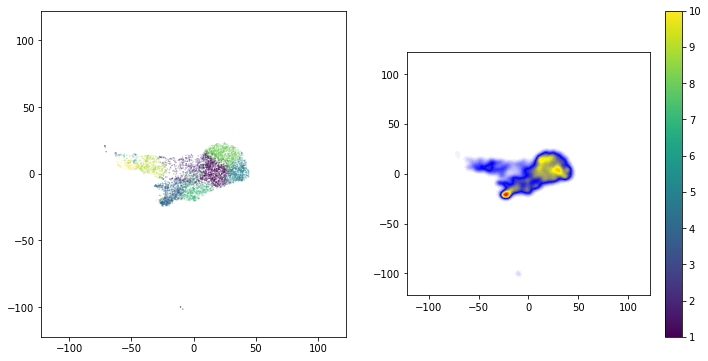

In [61]:
fig.colorbar(sc)
fig

In [7]:
from umap.parametric_umap import load_ParametricUMAP

#load_ParametricUMAP(parameters.projectPath+"/"+"UMAP")

In [8]:
#umap.plot.points(trainy, labels=clusters)

In [37]:
means = np.abs(sum_data["projections"]).std(axis=0)
norm_pro = sum_data["projections"]/means

In [39]:
norm_pro.max(axis=0)

array([30.98110098,  3.45211354,  4.04561435])

In [25]:
sum_data["kmeans_clusters"].shape, sum_data["projections"].shape

((1, 91704398), (91704398, 3))

In [4]:
fk = fish_keys[1]
cam, pos = fk.split("_")
is_back= pos==BACK
data = pd.concat([pd.concat(csv_of_the_day(cam,day, is_back=is_back)[1]) for day in days[:2]])
data_np = data[["x", "y"]].to_numpy()
data_px = data[["xpx", "ypx"]].to_numpy()
filter_d = error_default_points(data_px)
steps = calc_steps(data_np[~filter_d])
steps = steps[steps<5]
len(steps)
area_tuple = (fk,get_area_functions()(fk))

In [5]:
a1, a2 = area_f(fish_keys[0]), area_f(fish_keys[12])
area_t1 = (fish_keys[0],a1)
area_t2 = (fish_keys[12],a2)

In [7]:
data1, data2 = [pd.concat(csv_of_the_day(cameras[0], days[5], is_back=pos)[1])[["xpx", "ypx"]].to_numpy() for pos in [True,False]]

In [8]:
plt.plot(*normalize_origin_of_compartment(data2, area_f(cameras[0]+"_front"), is_back=False)[0].T)

In [7]:
area_t = (fk, area_f(fk))
X = transform_to_traces_high_dim(data_px, all_error_filters(data_px,area_t), area_t)
X.shape

(143583, 4)

In [6]:
days = get_all_days_of_context()
trace_size = 30
%time traces_all, nSs =calculate_traces([i for i in range(2)], days, trace_size, write_to_file=True)

AREA: 23442333_back,  10000 dataframes out of 143640 where on the other side of the tank. They are beeing filtered out.
Out of 226106 traces 6576 where filtered out because of nan values
CPU times: user 32.7 s, sys: 3.74 s, total: 36.4 s
Wall time: 39.3 s


In [7]:
%%time
pca = PCA()
traces_np = normalize_data_metrics(traces_as_numpy(traces_all))
pca_traces = pca.fit_transform(traces_np)
n_clusters = 4
clusters = clustering(pca_traces, n_clusters, rating_feature=traces_np[:,0])


CPU times: user 6.8 s, sys: 623 ms, total: 7.42 s
Wall time: 3.17 s


In [45]:
bar_plot_pca(pca,trace_size)

In [46]:
bar_plot_pca_loadings(pca, trace_size, names=list(range(3*trace_size)))

[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89]


In [44]:
def bar_plot_pca(pca, trace_size):
    y = pca.explained_variance_ratio_[:10]
    plt.bar(["%d" % (i + 1) for i in range(len(y))], y)
    plt.savefig(
        get_results_filepath(trace_size, "PCA_explained_variance_ratio"),
        bbox_inches="tight",
    )
    plt.close()


In [42]:
clusters_x, X_em = flt_on_key(days[2], DAY, traces_all, clusters, pca_traces)
cluster_means = [np.mean(X_em[clusters_x==idx],axis=0) for idx in range(n_clusters)]
t_d = transition_rates(clusters_x)
print(stationary_distribution(t_d))
g = draw_transition_graph(t_d,n_clusters, positions=cluster_means,flip_y=False,output="test.png")

(4, 4)
[0.16387057 0.38012625 0.20356453 0.25243865]
(4, 4)


In [43]:
single_plot_components(pca_traces, clusters, file_name="test")

In [2]:
#from graph_tool.draw import Graph, GraphView, graph_draw
#from graph_tool.inference import minimize_nested_blockmodel_dl

In [71]:
t = transition_rates_over_all(fish_keys, clusters, traces_all, trace_size)

In [ ]:
plot_transitions_individuality_develpoment(fish_keys, traces_all, pca_traces[:,:2], clusters,n_clusters,trace_size)

In [95]:

fig1 = draw_transition_graph(t,n_clusters,positions=get_cluster_means(traces_np[:,:2], clusters, n_clusters), flip_y=True, output="transitions_c%s.pdf"%t.shape[0])

(4, 4)


In [ ]:

def combine_scatter_graph(t, X_em, clusters):
    fig, ax = plt.subplots(nrows=1,ncols=1, figsize=(10,10))
    s = sample(range(X_em.shape[0]), 5000)
    X_sample=X_em[s]
    limits=sub_figure_get_limits(X_sample[:,0], X_sample[:,1], s=3)
    ax.set_xlim(limits[0], limits[1])
    ax.set_ylim(limits[2], limits[3])
    g = draw_transition_graph(t, X_em, clusters, ax=ax, flip_y=False, ink_scale=1, 
                              vweight_scale=100, eweight_scale=1,vertex_pen_width=0.01, output_size=(5000, 5000))
    scatter = sub_figure(ax, X_sample[:,0], X_sample[:,1],clusters[s], "PC1", "PC2", limits=limits)
    #
    #ax.axis('off')
    return fig
#

In [ ]:
entropy_density_main()

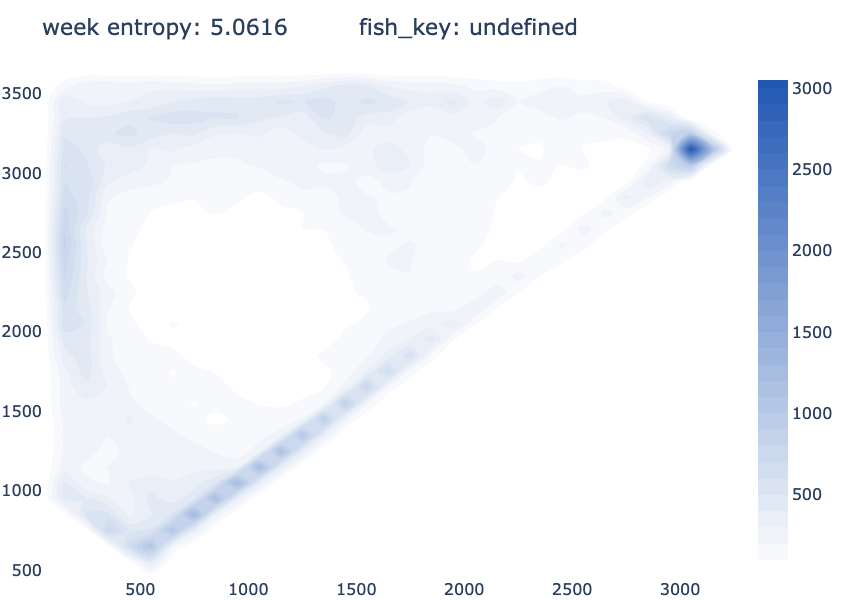

In [56]:
entropy_density_plot(data_px[~filter_d], area_tuple, timewindow="week")

In [ ]:
days_per_week = 7
list(range(days_per_week,len(days), days_per_week))

[7, 14, 21, 28]

(None, 5.060336412199188)

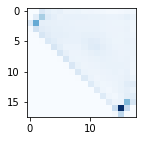

In [109]:
hist = entropy_heatmap(data_px[~filter_d], get_area_functions()(fk), bins=(18,18))
plt.imshow(hist, cmap='Blues', interpolation='nearest')
plt.savefig("entropy_heat.pdf"), entropy_for_chunk(data_px[~filter_d], (fk,get_area_functions()(fk)))

In [120]:
np.mean(steps[20000:20200]), np.percentile(steps[20000:20200], 50)

(0.7188156685163197, 0.6470933278985336)

In [179]:
%time median_data = activity(data_np, 200, all_error_filters(data_px, (fk,af(fk))))

CPU times: user 320 ms, sys: 86.3 ms, total: 406 ms
Wall time: 417 ms


In [189]:
import src.metrics.metrics as me 
%time median_data = me.activity(data_np, 200, all_error_filters(data_px, (fk,af(fk))))

CPU times: user 320 ms, sys: 30.1 ms, total: 350 ms
Wall time: 351 ms


In [178]:
median_data[1000:]

array([[  0.78369073, 200.        ],
       [  0.8954085 , 200.        ],
       [  0.95713253, 200.        ],
       ...,
       [  0.        , 200.        ],
       [  0.        , 200.        ],
       [  0.        , 115.        ]])

In [33]:
c, is_back = cameras[1],False
days = get_days_in_order(camera=c, is_back=is_back)
key, data = csv_of_the_day(c,days[-4], is_back=is_back)
data = pd.concat(data)
data = data[["xpx","ypx"]].to_numpy()

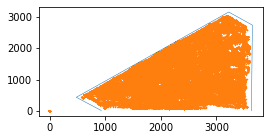

In [34]:

plt.plot(*area["%s_front"%c].T)
plt.plot(*data.T, "*")

Missing Areas: ['23520264_front', '23520270_front']
23442333_back


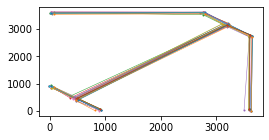

In [19]:
key = "%s_back"%cameras[0]
area = get_areas()[key]
print(key)

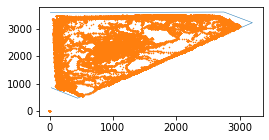

In [22]:
plt.plot(*area.T)
plt.plot(*batch2[["xpx","ypx"]].to_numpy().T, "*")

In [10]:
err = get_error_indices(batch4).to_numpy()

In [ ]:
np.where(err[1:] ^ err[:-1])

In [17]:
%%time
chunk = batch4[["xpx", "ypx"]].to_numpy()
activity(chunk, 20000, get_error_indices(batch4).to_numpy())

CPU times: user 5 ms, sys: 2.85 ms, total: 7.85 ms
Wall time: 10.5 ms


array([[2.67040135, 3.68954717],
       [1.73214786, 2.97969324],
       [3.00819779, 3.79347221],
       [3.28067154, 3.65334783],
       [3.68053384, 3.53930681],
       [4.27723504, 3.53488919],
       [3.98058264, 3.71210106],
       [4.32695133, 3.3103991 ]])

In [251]:
rr = entropy_per_interval(fish_ids=12, time_interval=500, write_to_csv=True)

In [333]:
c,p =get_fish2camera_map()[6]
p == BACK, p, c

(True, 'back', '23520266')

In [334]:
cpk = get_camera_pos_keys()
"23520266_back" in cpk
cpk.index("23520266_back")

6

In [335]:
camera='23520266_test'
days = get_days_in_order(camera=camera, is_back=False)
csv_of_the_day(camera, days[4], is_back=False)

([], [])

In [122]:

%time traces, nSs = get_traces([0,1], days[2:7], 200)

CPU times: user 5.42 s, sys: 553 ms, total: 5.97 s
Wall time: 6.46 s


In [123]:
tsne_model = TSNE(n_components=2, perplexity=50.0, init='pca', learning_rate=100)

%time X_embedded = tsne_model.fit_transform(PCA().fit_transform(traces))

CPU times: user 3min 45s, sys: 4.05 s, total: 3min 49s
Wall time: 30.8 s


In [124]:
from sklearn.cluster import MiniBatchKMeans, SpectralClustering

n_c = 6
pca = PCA()
pca_traces = pca.fit_transform(traces)
KM = MiniBatchKMeans(n_clusters=n_c)
c = KM.fit_predict(X_embedded)
KM2 = MiniBatchKMeans(n_clusters=n_c)
c2 = KM.fit_predict(pca_traces)

In [398]:
MDS_model = MDS(n_components=2)
%time MDS_embedded = MDS_model.fit_transform(PCA().fit_transform(traces[:2000]))

CPU times: user 2min 17s, sys: 30.1 s, total: 2min 47s
Wall time: 1min 25s


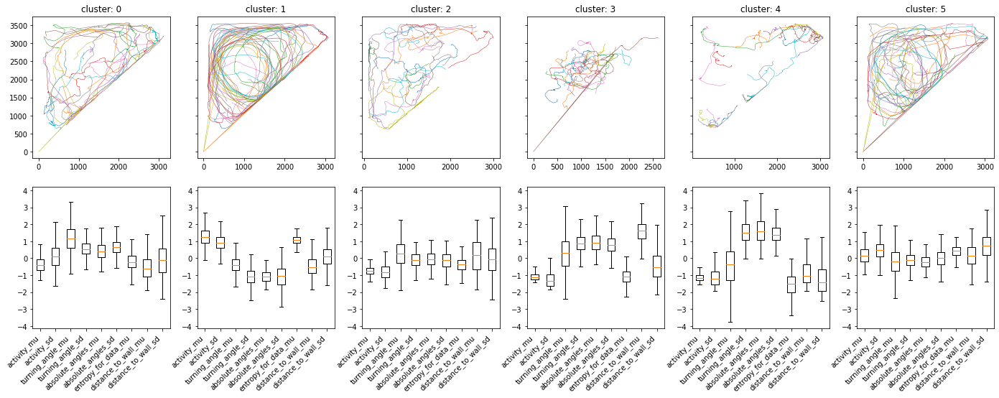

In [132]:


from random import sample

def plot_lines_for_cluster(traces, samples, clusters, n_clusters, limit=10, fig_name="line_clusters.pdf"):
    nrows=2
    fig, axs = plt.subplots(nrows=nrows,ncols=n_clusters, figsize=(n_clusters*4,nrows*4), sharey="row")
    for cluster_id in range(n_clusters):
        ax_b = axs[1,cluster_id]
        ax = axs[0,cluster_id]
        boxplot_characteristics_of_cluster(traces[clusters==cluster_id], ax_b)
        samples_c_i = samples[clusters==cluster_id]
        select = sample(range(len(samples_c_i)),k=limit)
        plot_lines(samples_c_i[select], ax=ax, title="cluster: %d"%(cluster_id))
        ax_b.yaxis.set_tick_params(which='both', labelbottom=True)

    fig.savefig(fig_name)
plot_lines_for_cluster(traces, nSs, c2, n_c, limit=20)

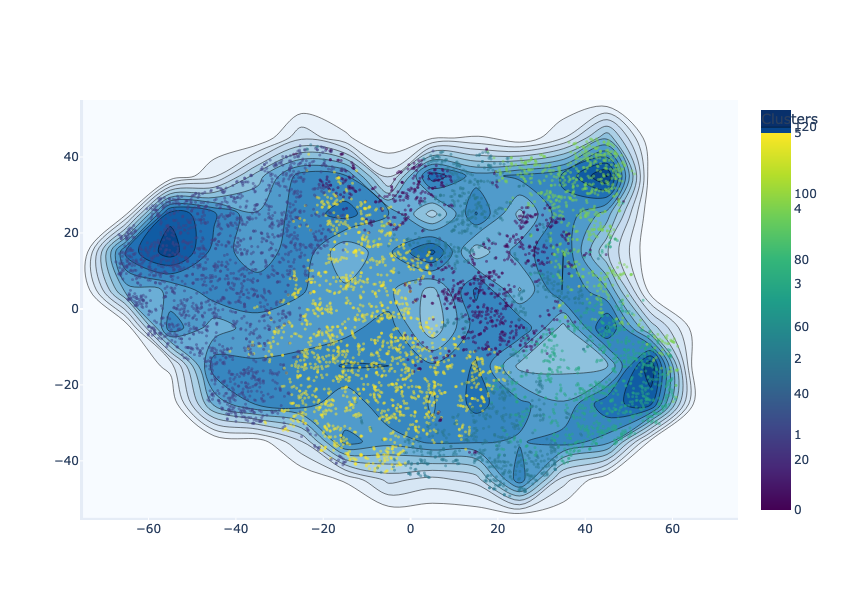

In [126]:
TSNE_vis_2(X_embedded, clusters=c2)

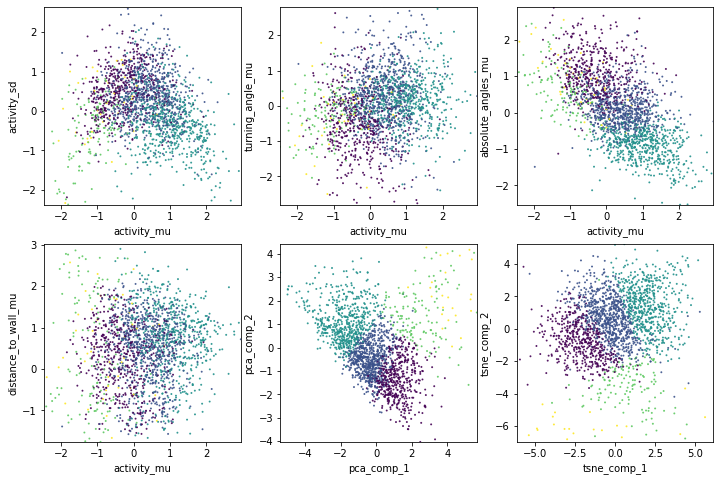

In [405]:
from main import metric_names

def sub_figure(ax, x, y, clusters,x_label, y_label):
    ax.scatter(x,y,c=clusters, cmap=plt.get_cmap("viridis"), alpha=0.8)
    ax.set_xlabel(x_label)
    ax.set_ylabel(y_label)
    m_x, std_x, x_min, x_max = np.mean(x), np.std(x), np.min(x), np.max(x)
    m_y, std_y, y_min, y_max = np.mean(y), np.std(y), np.min(y), np.max(y)
    s = 3
    ax.set_xlim(max(-s*std_x+m_x, x_min),min(m_x+std_x*s,x_max))
    ax.set_ylim(max(-s*std_y+m_y, y_min),min(m_y+std_y*s, y_max))

def plot_components(traces, clusters, X_tsne):
    fig, axs = plt.subplots(nrows=2,ncols=3, figsize=(4*3,4*2))
    combi = [[0,1], [0,2], [0,4], [0,-2]]
    axs = np.concatenate(axs)
    m_f, metric_names = get_metrics_for_traces()
    for i in range(0,4): 
        idx_x, idx_y = combi[i]
        x,y = traces[:,idx_x],traces[:,idx_y]
        sub_figure(axs[i],x,y,clusters,metric_names[idx_x], metric_names[idx_y])

    X_pca = PCA(n_components=2).fit_transform(traces)
    sub_figure(axs[4], X_pca[:,0], X_pca[:,1],clusters, "pca_comp_1", "pca_comp_2")
    sub_figure(axs[5], X_tsne[:,0], X_tsne[:,1], clusters,  "tsne_comp_1", "tsne_comp_2")
    fig.savefig("clustering_lines.pdf")
    
plot_components(traces[:2000], c2, MDS_embedded)

In [135]:
pca = PCA()
pca_r = pca.fit_transform(traces)

In [188]:
print(pca.explained_variance_ratio_, np.sum(abs(pca.components_), axis=0))
names = get_metrics_for_traces()[1]
del names[7]
print(names)
df_pca = pd.DataFrame(dict(zip(names, abs(pca.components_.T))))
df_pca

[5.74433513e-01 1.51268472e-01 1.12899169e-01 8.66767694e-02
 4.63410890e-02 1.30789339e-02 1.01774756e-02 5.09572822e-03
 2.88500402e-05] [2.55173669 2.46042629 1.72886296 2.1034029  2.55809049 2.66593805
 2.33703926 1.88776953 2.22583351]
['activity_mu', 'activity_sd', 'turning_angle_mu', 'turning_angle_sd', 'absolute_angles_mu', 'absolute_angles_sd', 'entropy_for_data_mu', 'distance_to_wall_mu', 'distance_to_wall_sd']


,activity_mu,activity_sd,turning_angle_mu,turning_angle_sd,absolute_angles_mu,absolute_angles_sd,entropy_for_data_mu,distance_to_wall_mu,distance_to_wall_sd
0,0.402966,0.350141,0.079302,0.409973,0.417438,0.386092,0.415872,0.110287,0.179497
1,0.163140,0.231609,0.112508,0.107111,0.065303,0.132837,0.024609,0.733333,0.579067
2,0.108418,0.145751,0.910744,0.165146,0.140254,0.191699,0.033702,0.131405,0.188286
3,0.129086,0.465577,0.356514,0.318964,0.198729,0.411097,0.179444,0.158072,0.521588
4,0.297739,0.345976,0.136343,0.114660,0.077155,0.138738,0.171524,0.633204,0.551676
5,0.511471,0.654307,0.041797,0.150893,0.230384,0.060282,0.472489,0.074460,0.016211
6,0.506710,0.094951,0.057898,0.004137,0.435660,0.431815,0.580976,0.010485,0.130203
7,0.418809,0.170046,0.027796,0.023219,0.597321,0.479730,0.450383,0.034630,0.058255
8,0.013398,0.002068,0.005961,0.809300,0.395847,0.433647,0.008040,0.001892,0.001052


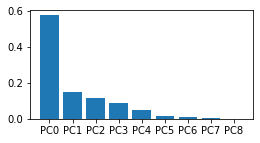

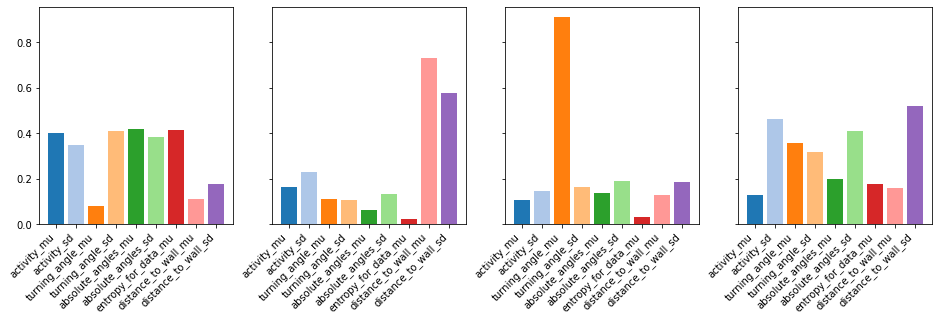

In [189]:
from matplotlib import cm
y = pca.explained_variance_ratio_
plt.bar(["PC%d"%i for i in range(len(y))],pca.explained_variance_ratio_)
pca_np = df_pca.to_numpy()
n=4
fig, axs = plt.subplots(nrows=1,ncols=n, figsize=(n*4,1*4), sharey="row")
for i in range(n):
    axs[i].bar(df_pca.columns,pca_np[i], color=cm.get_cmap("tab20")(range(9)))
    plt.setp(axs[i].get_xticklabels(), rotation=45, ha="right")

In [75]:
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.metrics import silhouette_score, davies_bouldin_score
def csm(A,B):
    num=np.dot(A,B.T)
    p1=np.sqrt(np.sum(A**2,axis=1))[:,np.newaxis]
    p2=np.sqrt(np.sum(B**2,axis=1))[np.newaxis,:]
    return num/(p1*p2)

In [47]:
S2 = cosine_similarity(X_embedded,X_embedded)

In [43]:
S = cosine_similarity(X_embedded,X_embedded)

In [65]:
davies_bouldin_score(X_embedded, c)

0.8641776577304924

In [66]:
davies_bouldin_score(traces[:,:2], c)

1.7026161623993836

In [55]:
silhouette_score(X_embedded, c)

0.3764099

In [ ]:
def verification_of_results():
    for i in range(2):
        X_e = TSNE(n_components=2, perplexity=200.0, init='random', learning_rate=200).fit_transform(traces)
    

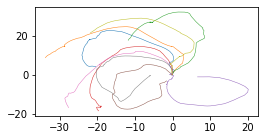

In [69]:
lines_to_plot = get_neighbourhood_selection(X_embedded, nSs, -16, -30.0, radius=2)
plot_lines_cumsum(lines_to_plot, limit=10)

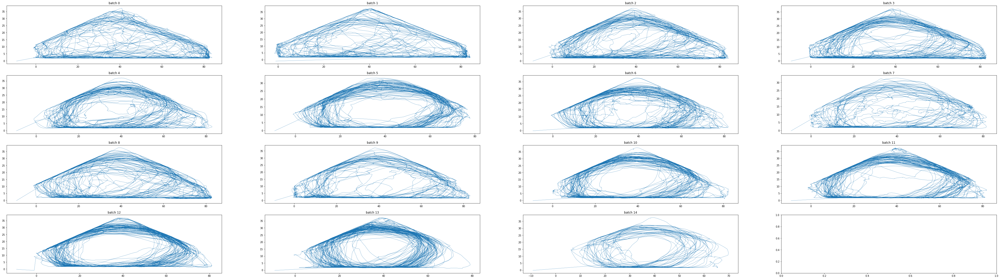

In [316]:
fig, axs = plt.subplots(nrows=4,ncols=4, figsize=(18*4,5*4))

for i, axi in enumerate(axs):
    for j, ax in enumerate(axi):
        idx = i*4+j
        if idx >= len(batches): continue
        b = batches[idx]
        ax.plot(b["x"], b["y"])
        ax.set_title("batch %d"%(i*4+j))

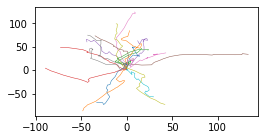

In [8]:
newSet = np.concatenate((nS, nS2))
for i in range(half-20, half):
    line = np.cumsum(newSet[i],axis=0)
    plt.plot(line[:,0], line[:,1])

In [17]:
sorted_X = X_embedded.argsort(axis=0)

x: 23.227289, y: -0.776792
x: 48.070713, y: 24.563509
x: 43.817989, y: 10.343863
x: 31.407816, y: -24.496689
x: 42.355297, y: 9.981595
x: 44.978920, y: 22.446413
x: 45.133709, y: 11.989365
x: 42.860409, y: 10.879012
x: 43.421398, y: 11.353261
x: 47.120979, y: 14.399659


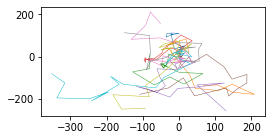

In [32]:
X_embedded

array([[ 21.22665  , -36.966583 ],
       [ 52.561314 ,  -4.767235 ],
       [ 53.200603 , -10.683019 ],
       ...,
       [ -4.941453 ,   3.3332672],
       [  8.791086 ,  -5.5832725],
       [-51.764282 ,   7.719418 ]], dtype=float32)

x: -36.984779, y: 9.652749
x: -38.533607, y: -0.623400
x: -31.975689, y: 8.220291
x: -36.921467, y: 0.914222
x: -34.921757, y: -1.606503
x: -30.323898, y: -0.636672
x: -34.473980, y: -0.472880
x: -36.830254, y: -2.007072
x: -34.530277, y: 0.584574
x: -35.320625, y: 0.954203


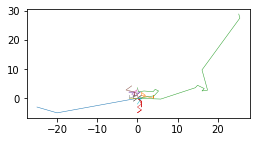

In [73]:
for i in range(10):
    arg = sorted_X[(i+1)][0]
    print("x: %f, y: %f"%(X_embedded[arg,0], X_embedded[arg,1]))
    line = np.cumsum(nSs[arg], axis=0)
    plt.plot(line[:,0], line[:,1])

In [628]:
import plotly.express as px
from scipy.spatial import ConvexHull, convex_hull_plot_2d

def get_convex_hull(points): 
    hull = ConvexHull(points)
    cycle = points[hull.vertices]
    cycle = np.concatenate([cycle, cycle[:1]])
    return cycle

colors_go = ['aggrnyl', 'agsunset', 'algae', 'amp', 'armyrose', 'balance',
             'blackbody', 'bluered', 'blues', 'blugrn', 'bluyl', 'brbg',
             'brwnyl', 'bugn', 'bupu', 'burg', 'burgyl', 'cividis', 'curl',
             'darkmint', 'deep', 'delta', 'dense', 'earth', 'edge', 'electric',
             'emrld', 'fall', 'geyser', 'gnbu', 'gray', 'greens', 'greys',
             'haline', 'hot', 'hsv', 'ice', 'icefire', 'inferno', 'jet',
             'magenta', 'magma', 'matter', 'mint', 'mrybm', 'mygbm', 'oranges',
             'orrd', 'oryel', 'oxy', 'peach', 'phase', 'picnic', 'pinkyl',
             'piyg', 'plasma', 'plotly3', 'portland', 'prgn', 'pubu', 'pubugn',
             'puor', 'purd', 'purp', 'purples', 'purpor', 'rainbow', 'rdbu',
             'rdgy', 'rdpu', 'rdylbu', 'rdylgn', 'redor', 'reds', 'solar',
             'spectral', 'speed', 'sunset', 'sunsetdark', 'teal', 'tealgrn',
             'tealrose', 'tempo', 'temps', 'thermal', 'tropic', 'turbid',
             'turbo', 'twilight', 'viridis', 'ylgn', 'ylgnbu', 'ylorbr',
             'ylorrd']
mycolors=['reds', 'greens', 'blues']
colorscales = [
                [[0, 'rgb(255, 191,0)'], [1, 'rgb(255, 191,100)']],
                [[0, 'rgb(0,200,0)'], [1, 'rgb(0,255,100)']],
                [[0, 'rgb(200,0,0)'], [1, 'rgb(255,0,100)']],
                [[0, 'rgb(235, 52, 232)'], [1, 'rgb(235, 52, 232)']],
                [[0, 'rgb(235, 140, 52)'], [1, 'rgb(235, 140, 52)']]
              ]
bg_color='rgba(255,255,255,1)'
white2blue=[[0, bg_color], [1, 'rgb(32, 87, 179)']]

def draw_multi_density_TSNE(X_embedded, clusters, number_of_clusters, fig_name="multi_density_TSNE", start=20, end=100, size=15, width=3):
    x = X_embedded[:,0]
    y = X_embedded[:,1]
    res = [go.Histogram2dContour( x = x, y = y, contours=dict(coloring="fill", showlines=False), colorscale=white2blue, showscale=False)]
    for i in range(number_of_clusters):
        h2d = go.Histogram2dContour(opacity=0.7,showscale=False, line=dict(width=width),contours=dict(coloring="lines", start=start, end=end, size=size),
                                    x = x[clusters==i], y = y[clusters==i], autocolorscale=False,
                                    colorscale=colorscales[i])
        res.append(h2d)
    fig = go.Figure(res)
    fig.update_layout( height = 600, width = 600, showlegend=False, paper_bgcolor=bg_color, plot_bgcolor=bg_color, margin_t=0, margin_b=0, margin_l=0, margin_r=0)
    fig.update_xaxes(visible=False)
    fig.update_yaxes(visible=False)
    fig.write_image("%s.pdf"%fig_name)
    return fig

def draw_density_TSNE(X_embedded, clusters, number_of_clusters, fig_name="density_TSNE"):
    x = X_embedded[:,0]
    y = X_embedded[:,1]
    res = go.Histogram2dContour(x = x, y = y, colorscale = white2blue, showscale=False,contours=dict(coloring="fill", showlines=False))
    hulls = [go.Scatter( line = {"width": 5}, **dict(zip(["x","y"],get_convex_hull(X_embedded[clusters==i]).T))) for i in range(number_of_clusters)]
    fig = go.Figure(hulls + [res])
    fig.update_layout( height = 600, width = 600, showlegend=False, paper_bgcolor=bg_color, plot_bgcolor=bg_color, margin_t=0, margin_b=0, margin_l=0, margin_r=0)
    fig.update_xaxes(visible=False)
    fig.update_yaxes(visible=False)
    fig.write_image("%s.pdf"%fig_name)
    return fig

def draw_raw_density_TSNE(X_embedded, fig_name="raw_density_TSNE"):
    x = X_embedded[:,0]
    y = X_embedded[:,1]
    res = go.Histogram2dContour(x = x, y = y, colorscale = white2blue, showscale=False,contours=dict(coloring="fill", showlines=False))
    fig = go.Figure([res])
    fig.update_layout( height = 600, width = 600, showlegend=False, paper_bgcolor=bg_color, plot_bgcolor=bg_color, margin_t=0, margin_b=0, margin_l=0, margin_r=0)
    fig.update_xaxes(visible=False)
    fig.update_yaxes(visible=False)
    fig.write_image("%s.pdf"%fig_name)
    return fig

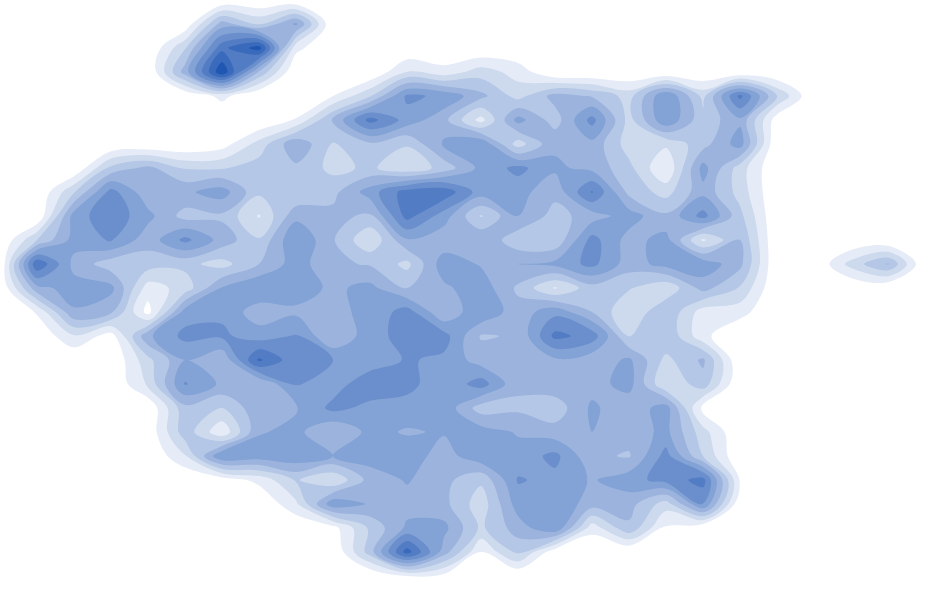

In [629]:
draw_raw_density_TSNE(X_embedded)

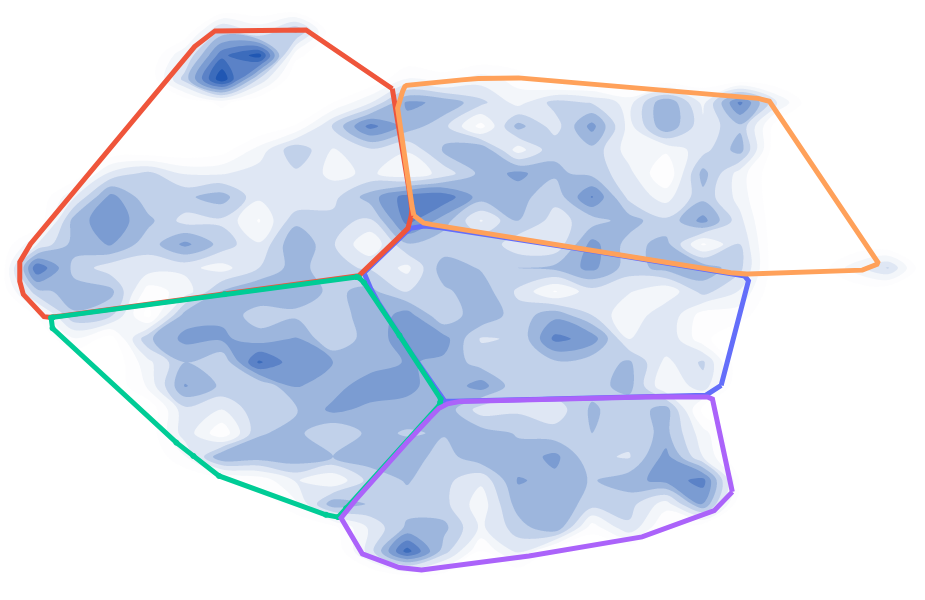

In [620]:
draw_density_TSNE(X_embedded, c, 5)

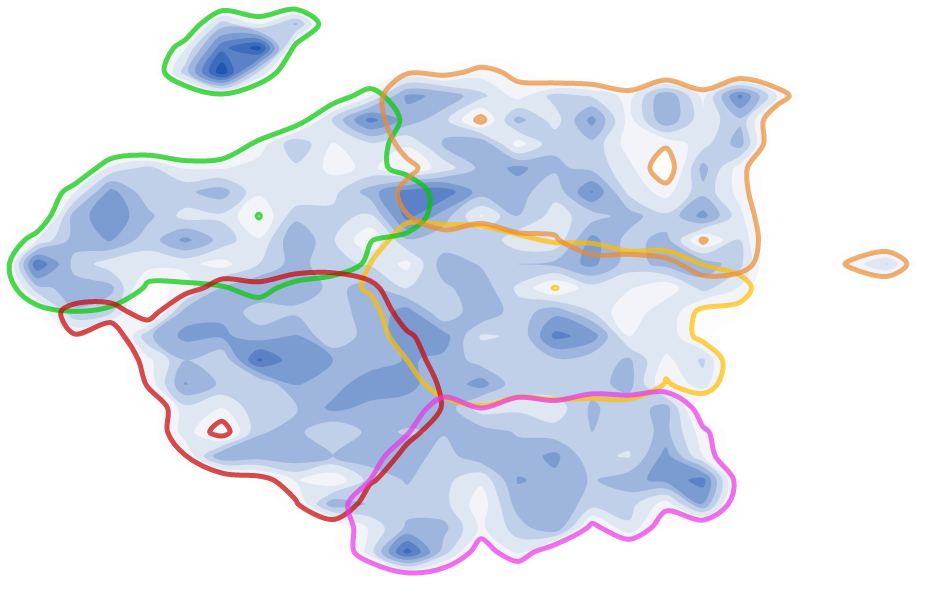

In [621]:
draw_multi_density_TSNE(X_embedded, c, 5, fig_name="5_clusters_fish_TSNE", size=80, width=5)

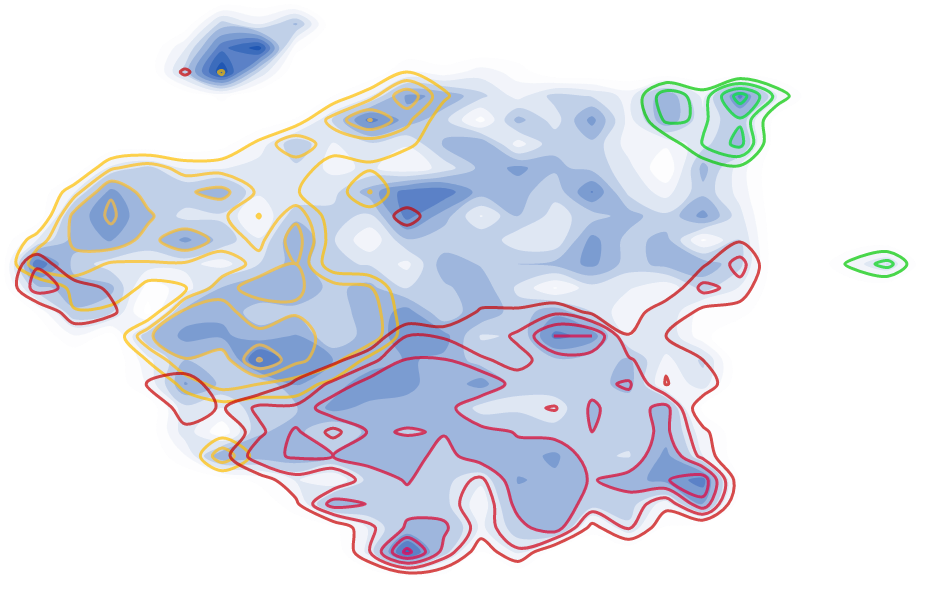

In [623]:
draw_multi_density_TSNE(X_embedded, c2, 3, fig_name="late_3_fish_TSNE")

2053
14376 [         -1          -1          -1 ... -2147483648 -2147483648
 -2147483648]


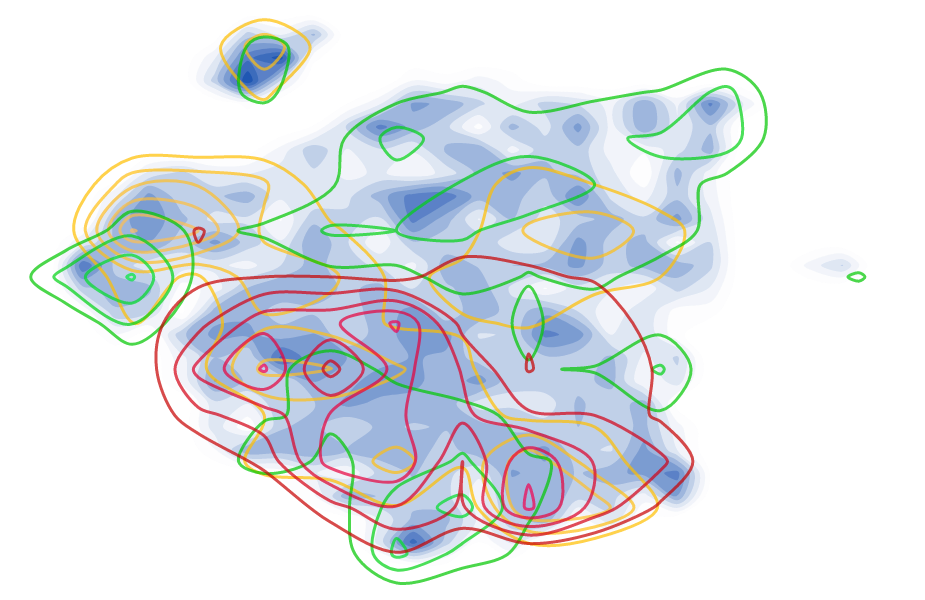

In [624]:
classes = np.zeros_like(c2)
classes.fill(np.nan)
step = c2.size//7
print(step)
clusters = [-1, 0, 2, 1, -1]
for i in range(5): 
    classes[i*step:(i+1)*step]=clusters[i]
print(classes.size, classes)
draw_multi_density_TSNE(X_embedded, classes, 3, fig_name="mid_3_fish_TSNE")

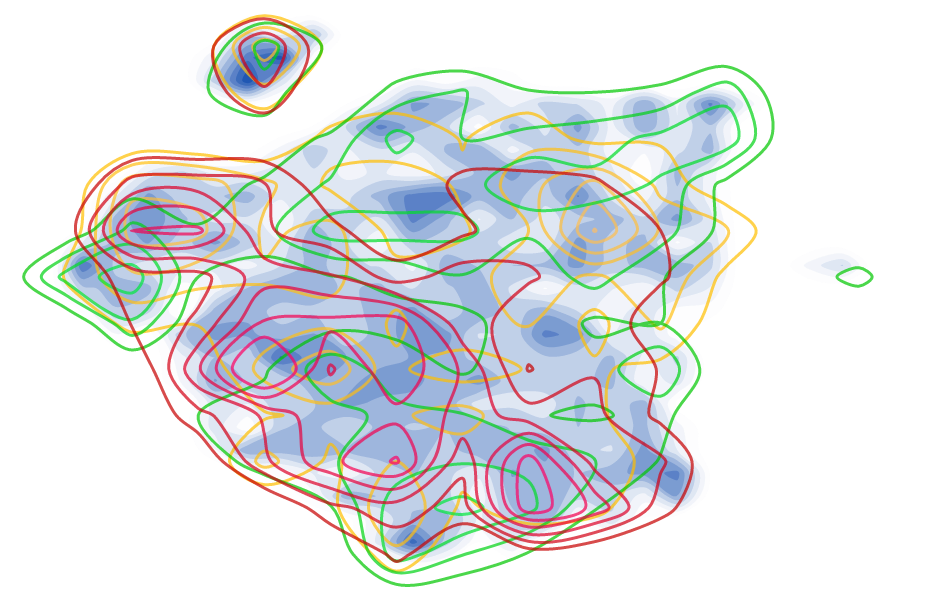

In [625]:
clusters = [-1, 0, 2, 1, -1]
sort_c = np.sort(c)
sort_c[sort_c==2]=10
sort_c[sort_c==1]=2
sort_c[sort_c==10]=1
draw_multi_density_TSNE(X_embedded, sort_c, 3, fig_name="early_3_fish_TSNE")